# 1. Load and convert labeled data into sequential datasets

path/to/labeled_data/ 

    ├── class_0/
    │   ├── sample1.pkl
    │   ├── sample2.csv
    │   └── ...
    ├── class_1/
    │   ├── sample1.csv
    │   ├── sample2.pkl
    │   └── ...
    └── ...

dict_label={'class_0':0, 'class_1':1, ... }

In [1]:
import numpy as np
import os
import pandas as pd
from torch.utils.data import Dataset
import torch
from torchinfo import summary 
import random
from torch.utils.data import random_split, DataLoader, Subset, ConcatDataset


class LoadSeqDataset(Dataset):
    def __init__(self, file_path: str, label: int, selected_features:list, seq_num=28, gap=5, desire_class = None):
        """
        Initialize the dataset from a labeled data file by converting it to sequential format.
        
        Args:
            file_path (str): Path to the labeled data file.
            label (int): Label associated with the sequences from this file.
            seq_num (int): Length of each sequence.
            gap (int): Step size between sequences.
        """
        self.seq_num = seq_num
        self.gap = gap
        self.selected_features = selected_features
        # Define dtype for selected features and label
        dtypes = {col: 'float32' for col in selected_features}
        dtypes['label'] = 'int8'  # Set label as an integer type
        dtypes['time'] = 'float32'  # Set label as an integer type
        # Load data and process into sequences

        self.data = pd.read_csv(file_path, usecols=selected_features + ['label', 'time'], dtype = dtypes)
        self.data.drop(columns='index', inplace=True, errors='ignore')
        self.data.label = self.data.label * label.item()
        self.df = self.data
        #self.sequences = self._make_sequences_contact_only()
        self.sequences = self._make_sequences()
        if desire_class is not None:
            self.sequences = self._get_specific_class(desire_class)
    def balanceData(self, split_rate_1 = 1, split_rate_0=0.15):
        """Balances the dataset by downsampling sequences where label = 0 to 10%."""
        # Separate sequences based on the label
        label_0_sequences = [seq for seq in self.sequences if seq[1] == 0]
        other_label_sequences = [seq for seq in self.sequences if seq[1] != 0]

        # Downsample label 0 sequences to 10%
        num_to_keep = int(len(label_0_sequences) * split_rate_0)
        downsampled_label_0 = random.sample(label_0_sequences, num_to_keep)

        num_to_keep = int(len(other_label_sequences) * split_rate_1)
        other_label_sequences = random.sample(other_label_sequences, num_to_keep)

        # Combine and shuffle
        balanced_sequences = downsampled_label_0 + other_label_sequences
        random.shuffle(balanced_sequences)

        # Update sequences
        self.sequences = balanced_sequences

    def _make_sequences_contact_only(self):
        """Generate sequences based on the contact points detected in the data."""
        start_contact_indexs = self.df.loc[self.df.label.diff() > 0.1, :].index
        end_contact_indexs = self.df.loc[self.df.label.diff() < -0.1, :].index - 1
        contact_indexs = [idx for idx, idx2 in zip(start_contact_indexs, end_contact_indexs) if idx2 - idx >= self.seq_num]

        sequences = []
        for contact_index in contact_indexs:
            end_point = contact_index + self.seq_num
            for step in range(contact_index, end_point, self.gap):
                window = self.df[self.selected_features][step - self.seq_num + 1:step + 1]
                sequences.append((window.values, self.df.label[step]))
        return sequences
    
    def _make_sequences(self):
        """Generate sequences over time"""
        sequences = []
        for step in range(self.seq_num,self.data.shape[0], self.gap):
            window = self.df[self.selected_features][step - self.seq_num:step]
            sequences.append((window.values, self.df.label[step-1]))
        
        return sequences

    def _get_specific_class(self, desired_label):
        filtered_data = [(seq, label) for seq, label in self.sequences if label == desired_label]
        return filtered_data


    def __len__(self):
        """Return the total number of sequences in the dataset."""
        return len(self.sequences)

    def __getitem__(self, idx):
        """
        Retrieve a single sequence and label.
        
        Args:
            idx (int): Index of the sequence to retrieve.
            
        Returns:
            (tuple): (features, target) where target is the label for classification.
        """
        #TODO: multiple features should be reshaped.
        features, target = self.sequences[idx]
        features = features.T if isinstance(features, torch.Tensor) else torch.tensor(features, dtype=torch.float32).T.clone().detach()
        target = target if isinstance(target, torch.Tensor) else torch.tensor(target, dtype=torch.long).clone().detach()
        return features, target


class LoadDatasets(Dataset):
    def __init__(self, data_path:str, dict_label = None):
        """
        Load sequential dataset from a directory structure with labeled subdirectories.

            Expected directory structure:
            
            path/to/data/
                ├── class_0/
                │   ├── sample1.pkl 
                │   ├── sample2.csv
                │   └── ...
                ├── class_1/
                │   ├── sample1.csv
                │   ├── sample2.pkl
                │   └── ...
                └── ...

            Label mapping example:
            
            dict_label = {'class_0': 0, 'class_1': 1, ... }
        
        Args:
            data_path (str): Path to the data directory.
            dict_label (dict, optional): Dictionary mapping class folder names to labels.
        """
        if dict_label is None:
            dict_label = {'a': 7, 'b': 6, 'c': 5, 'd': 4, 'e': 3, 'f': 2, 'g': 1}
            #dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1}

        
        self.samples = []
        self.class_to_idx = {}

        # Scan data_path for subdirectories        
        for class_name in sorted(os.listdir(data_path)):
            class_dir = os.path.join(data_path, class_name)
            if os.path.isdir(class_dir) and class_name in dict_label:
                label = dict_label[class_name]  # Look up label
                self.class_to_idx[class_name] = label
                for file_name in os.listdir(class_dir):
                    file_path = os.path.join(class_dir, file_name)
                    if os.path.isfile(file_path):
                        self.samples.append((file_path, label))
                        
    def __len__(self):
        """Return the total number of samples."""
        return len(self.samples)

    def __getitem__(self, idx):
        """
        Retrieve a single sample at the specified index.
        
        Args:
            idx (int): Index of the sample to retrieve.
            
        Returns:
            tuple: (file_path, label)
        """
        seq_path, label = self.samples[idx]
        return seq_path, label

# 2. load AI models

In [2]:
import argparse
import os
import time
import torch
import numpy as np
import random
import torch.optim as optim
import torch.nn as nn
from torchmetrics import ConfusionMatrix, Accuracy
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torch.nn.utils.rnn import pack_padded_sequence, pad_packed_sequence

   
class ZScoreNormalization(nn.Module):
    def __init__(self):
        super(ZScoreNormalization, self).__init__()

    def forward(self, x, seq_pose=2):
        # Normalize each slice along index=2 independently
        mean = torch.mean(x, dim=seq_pose, keepdim=True)  # Mean across the sequence dimension
        std = torch.std(x, dim=seq_pose, keepdim=True)   # Std across the sequence dimension
        
        # Apply z-score normalization per time sequence
        normalized_x = (x - mean) / (std + 1e-6)  # Avoid division by zero with epsilon
        
        return normalized_x

class cnnLSTM(nn.Module):
    def __init__(self, num_features_joints=28, hidden_size=32, num_layers=3, dropout=0.5, bidirectional=False):
        super(cnnLSTM, self).__init__()
        self.normalization = nn.LayerNorm(num_features_joints)#ZScoreNormalization()
        
         # Define the 1D CNN layers
        self.cnn1 = nn.Conv1d(in_channels=num_features_joints, out_channels=256, kernel_size=1, padding='same',padding_mode='circular')
        self.cnn2 = nn.Conv1d(in_channels=256, out_channels=512, kernel_size=2, padding='same',padding_mode='circular')
        self.cnn3 = nn.Conv1d(in_channels=512, out_channels=256, kernel_size=4, padding='same',padding_mode='circular')
        
        self.bn1 = nn.BatchNorm1d(256)
        self.bn2 = nn.BatchNorm1d(512)
        self.bn3 = nn.BatchNorm1d(256)
        
        self.relu = nn.LeakyReLU() #nn.ReLU()
        self.pool = nn.MaxPool1d(kernel_size=2)
        self.dropout_cnn = nn.Dropout(0.3)
        
        
        # Define the LSTM layer
        self.lstm = nn.LSTM(
            input_size=256//2,
            hidden_size=hidden_size,
            num_layers=num_layers,
            batch_first=True,
            bidirectional=bidirectional,
            dropout=dropout if num_layers > 1 else 0  # Dropout only if num_layers > 1
        )

        lstm_output_size = hidden_size * 2 if bidirectional else hidden_size
        self.normalization_lstm = nn.LayerNorm(lstm_output_size)
        
        # Fully connected layer
        self.fc = nn.Linear(lstm_output_size, 1)

        # Dropout for regularization
        self.dropout_fc = nn.Dropout(dropout)
        
        

    def forward(self, input, freeze_last_layer=False):
        # Normalize input (batch_size, sequence_length, input_size)
        self.lstm.flatten_parameters()

        normalized_input = self.normalization(input)

        # Reshape for CNN: (batch_size, in_channels, sequence_length)
        cnn_input = normalized_input.permute(0, 2, 1)
        
        # Apply CNN layers
        cnn_out = self.relu(self.bn1(self.cnn1(cnn_input)))#, seq_pose = 1))
        cnn_out = self.relu(self.bn2(self.cnn2(cnn_out)))#, seq_pose = 1))
        cnn_out = self.relu(self.bn3(self.cnn3(cnn_out)))#, seq_pose = 1))
        cnn_out = cnn_out.permute(0,2,1)
        cnn_out = self.pool(cnn_out)

        # Reshape for LSTM: (batch_size, sequence_l98pength, input_size)

        lstm_out, _ = self.lstm(cnn_out)
        self.normalization_lstm(lstm_out)

        # Apply dropout
        lstm_out = self.dropout_fc(lstm_out)
        
        # Fully connected layer

        joint_step_outputs = self.fc(lstm_out).squeeze(-1)  # (batch_size, joint_dof, 1) -> (batch_size, joint_dof)
        
        return joint_step_outputs
    
    def prediction(self, input):
        device = input.device
        output = self.forward(input)
        
        # Check if all elements are masked (-inf) for each sample
        nocontact_masked = (output <= 0).all(dim=1)  # True if all entries are masked

        # Find the index of the max value (ignoring masked ones)
        predictions = torch.argmax(output, dim=1)+1  # Get index of max valid value
        predictions[nocontact_masked] = 0
        return predictions


# 3. Training

In [3]:
# functions
import copy
import plotly.express as px
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
# Using plotly + cufflinks in offline mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)
from collections import Counter
def create_hierarchical_labels(contact_indices, num_links):
    """
    Generate hierarchical labels for a batch of contact indices.
    
    Args:
        contact_indices (Tensor): A tensor of shape [batch_size] with the contact index for each example in the batch.
        num_links (int): The number of links (length of the output vector).
    
    Returns:
        Tensor: A tensor of shape [batch_size, num_links] containing hierarchical labels for each example.
    """
    batch_size = contact_indices.size(0)  # Get batch size
    y_true = torch.zeros(batch_size, num_links, dtype=torch.float32, device=contact_indices.device)  # Initialize a tensor of zeros
    
    for i in range(batch_size):
        contact_index = contact_indices[i]
        if contact_index>0:
            y_true[i, contact_index-1 ] = 1  # Set the values up to contact_index to 1
            #y_true[i, 0:contact_index-1 ] = 0.8  # Set the values up to contact_index to 1
    
    return y_true
def majority_voting_last_n(model_out, n):
    """
    Apply majority voting for each step considering the last `n` items.

    Args:
        model_out (pd.Series): Predicted classes for each step.
        n (int): Number of previous items (including the current one) to consider for voting.

    Returns:
        pd.Series: Smoothed predictions based on majority voting.
    """
    smoothed_predictions = model_out.copy()  # Copy to retain index
    for i in range(n, len(model_out), 1):
        # Define the window
        start_idx = i - n 
        end_idx = i  # Include the current item
        window = model_out.iloc[start_idx:end_idx]
        
        # Perform majority voting
        most_common = Counter(window).most_common(1)[0][0]
        smoothed_predictions.iloc[i-1] = most_common
    
    return smoothed_predictions

def train_loop(model, dataset_loader,selected_features, lr, n_epochs, freeze_last_layer=False): #--> 
    model.train()
    # Use Adam optimizer and CrossEntropyLoss as the loss function
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)
    # Initialize learning rate scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=1, verbose=True)
    loss_seq = []
    lr_seq = []
    # Training loop
    for epoch in range(n_epochs):
        running_loss = []
        for trial_dataset_path, label in dataset_loader:
            
            data = LoadSeqDataset(file_path = trial_dataset_path[0], label= label[0],  selected_features= selected_features, seq_num=seq_num, gap=gap)
            
            dataloader = DataLoader(data, batch_size=batch_size, shuffle=True)
        
            for X_batch, y_batch in dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device) # Move data to device
                optimizer.zero_grad()
                # Generate noise and shift as PyTorch tensors
                y_pred = model(X_batch)
                loss = loss_fn(y_pred, y_batch)
                
                loss.backward()
                optimizer.step()
                running_loss.append(loss.cpu().detach().numpy())

        avg_loss = np.mean(running_loss)
        print(f"Epoch: {epoch + 1}/{n_epochs} - learning rate: {optimizer.param_groups[0]['lr']:.5f}, classification loss: {avg_loss:.4f}")
        # Update the scheduler with the average loss
        scheduler.step(avg_loss)
        current_lr = optimizer.param_groups[0]['lr']
        if current_lr < lr_threshold:
            print(f"Learning rate has dropped below the threshold of {lr_threshold}. Stopping training.")
            break
        loss_seq.append(avg_loss)
        lr_seq.append(current_lr)

    return model, loss_seq, lr_seq

def plot_loss(loss_seq, lr_seq):
    fig, ax1 = plt.subplots(figsize=(10, 6))

    # Plot loss on the primary y-axis
    ax1.plot(loss_seq, label='Loss', color='blue', marker='o')
    ax1.set_xlabel('Epochs', fontsize=14)
    ax1.set_ylabel('Loss', fontsize=14)
    ax1.tick_params(axis='y', labelcolor='blue')
    
    # Set y-axis limits for loss to include 0
    ax1.set_ylim(bottom=0, top=max(loss_seq) * 1.05)  # Adjust top limit as needed

    ax1.grid(True)

    # Create a secondary y-axis
    ax2 = ax1.twinx()
    ax2.plot(lr_seq, label='Learning Rate', color='red', marker='o')
    ax2.set_ylabel('Learning Rate', fontsize=14)
    ax2.tick_params(axis='y', labelcolor='red')

    # Set y-axis limits for learning rate to include 0
    ax2.set_ylim(bottom=0, top=max(lr_seq) * 1.05)  # Adjust top limit as needed

    # Add legends
    lines, labels = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines + lines2, labels + labels2, loc='best')

    # Improve layout
    plt.tight_layout()

    # Show the plot
    plt.show()


def validation(dataloaders, names, model,print_data = False):
    model.eval()
    accuracies = []
    with torch.no_grad():
        confusionMatrix = ConfusionMatrix(task="multiclass", num_classes=num_classes)
        accuracy_metric = Accuracy()
        for i in range(len(dataloaders)):
            y_pred, y_test = get_output(dataloaders[i], model, device)
            accuracy_metric.update(y_pred, y_test)
            accuracy = accuracy_metric.compute()
            if print_data: 
                print("Accuracy on ", names[i], ': ', accuracy)
            accuracies.append(accuracy.item()*100)  # Collect accuracy for plotting
            accuracy_metric.reset()
    return accuracies

# Bar chart plotting function
def plot_accuracies(pre_accuracies, post_accuracies, dataloader_names, model_name):
    labels = dataloader_names
    bar_width = 0.35
    index = range(len(labels))

    # Plotting the barchart
    plt.figure(figsize=(10, 6))
    plt.grid(True)

    bars1 = plt.bar(index, pre_accuracies, bar_width, label='Pre-DomainAdaptation Accuracy', color='blue')
    bars2 = plt.bar([i + bar_width for i in index], post_accuracies, bar_width, label='Post-DomainAdaptation Accuracy', color='green')

    # Set y-axis limits from 0 to 100
    plt.ylim(0, 120)

    # Adding labels, title, and legend
    plt.xlabel('Test Dataset', fontsize=14)
    plt.ylabel('Accuracy (%)', fontsize=14)  # Indicating accuracy as a percentage
    plt.title(f'Accuracy Comparison for {model_name}', fontsize=16)
    plt.xticks([i + bar_width / 2 for i in index], labels)
    plt.legend()

    # Adding accuracy values on top of the bars
    for bar in bars1:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, yval + 1, f'{yval:.2f}', ha='center', fontsize=12)

    for bar in bars2:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, yval + 1, f'{yval:.2f}', ha='center', fontsize=12)

    # Show the plot
    plt.tight_layout()
    plt.show()


In [54]:
# hyperparameters
import pickle
seq_num = 80
gap = 3
data_name = 'ur5'
dof = 6
# Load the dataset from the file
with open(f'/home/rzma/myProjects/contactInterpretation/dataset/{data_name}/pickleDatasets_0_2/{data_name}_feature_e_gap_{gap}_splitRate_0.75_seqNum_{seq_num}.pickle', 'rb') as f:
    master_dataset_franka = pickle.load(f)
print("Dataset loaded!")
batch_size = 64

torch.manual_seed(2020)
np.random.seed(2020)
random.seed(2020)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if device.type == "cuda":
    print("Using GPU:", torch.cuda.get_device_name())


# Build the model
model_cnnLSTM = cnnLSTM(num_features_joints=seq_num, num_layers=1, hidden_size=128, dropout=0.7, bidirectional=True)
models = [model_cnnLSTM, model_cnnLSTM]
models_names = ['model_lstmBlock',  'model_cnnLSTM',]
for model in models:
    model.to(device)

loss_fn = nn.CrossEntropyLoss()
#loss_fn = nn.BCEWithLogitsLoss()
#loss_fn = nn.MultiLabelSoftMarginLoss()

n_epochs = [35, 20]

Dataset loaded!
Using GPU: Quadro RTX 8000


In [ ]:
# Load data and create training and testing sets
gap = 5
split_rate = 0.75
data_path, dof = (os.getcwd().replace('AIModels','') +'/dataset/franka_main/labeled_data/', 7)
#dict_label = dict_label = {'link7': 6, 'link6':5, 'link5':4, 'link4':3, 'link3':2, 'link2':1, 'link1':0}
dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(dof)]#+[ f'de{i}' for i in range(robot_dof)]

training_datasets = LoadDatasets(data_path, dict_label)
train_datasetloader = DataLoader(training_datasets, batch_size=1, shuffle=True)

# Initialize counters
total_samples_counter = 0
train_samples_counter = 0
master_dataset = []
state = False
# Iterate through test_datasetloader
for trial_dataset_path, label in train_datasetloader:
    #if 't2.csv' in trial_dataset_path[0] or 't1.csv' in trial_dataset_path[0]:
        # Load the dataset for the trial
        data = LoadSeqDataset(file_path=trial_dataset_path[0], label=label[0], selected_features=selected_features, seq_num=seq_num, gap=gap)

        '''# Count total samples
        total_samples = len(data)
        total_samples_counter += total_samples

        data.balanceData()
        # Calculate number of samples for the subset (5% of the data)
        num_samples = len(data)
        train_samples_counter += num_samples

        #master_dataset.append(data)
        if state:
            master_dataset.sequences = master_dataset.sequences + data.sequences 
        else:
            master_dataset = data
            state = True
            # Count total samples'''
        total_samples = len(data)
        total_samples_counter += total_samples
        # Create a subset of the data
        data.sequences = data.sequences[0:total_samples//2]

        data.balanceData(split_rate_1=split_rate, split_rate_0=split_rate*0.2)
        # Calculate number of samples for the subset (5% of the data)
        num_samples = len(data)
        train_samples_counter += num_samples
        master_dataset.append(data)

# Combine all subsets into a single dataset
master_dataset_franka = ConcatDataset(master_dataset)
print(f"Total samples across all trials: {total_samples_counter}")
print(f"Total samples used for training ({train_samples_counter/total_samples_counter*100}% of data): {train_samples_counter}")

train_dataloader = DataLoader(master_dataset_franka, batch_size=len(master_dataset_franka), shuffle=True)
unique_labels, counts = 0 , 0
for X_batch, y_batch in train_dataloader:
    unique_labels, b = y_batch.unique(return_counts=True)
    counts += b
print(f"Unique labels: {unique_labels}")
print(f"Counts: {counts}")
print(f"Batch shape: {y_batch.shape}")

-----------------------------    model_cnnLSTM ----------------------------- 
Epoch: 1/[35, 20] - learning rate: 0.00200, classification loss: 1.4027
Epoch: 2/[35, 20] - learning rate: 0.00200, classification loss: 1.0319
Epoch: 3/[35, 20] - learning rate: 0.00200, classification loss: 0.7754
Epoch: 4/[35, 20] - learning rate: 0.00200, classification loss: 0.5424
Epoch: 5/[35, 20] - learning rate: 0.00200, classification loss: 0.3904
Epoch: 6/[35, 20] - learning rate: 0.00200, classification loss: 0.2450
Epoch: 7/[35, 20] - learning rate: 0.00200, classification loss: 0.1896
Epoch: 8/[35, 20] - learning rate: 0.00200, classification loss: 0.1466
Epoch: 9/[35, 20] - learning rate: 0.00200, classification loss: 0.1296
Epoch: 10/[35, 20] - learning rate: 0.00200, classification loss: 0.0752
early stopping!


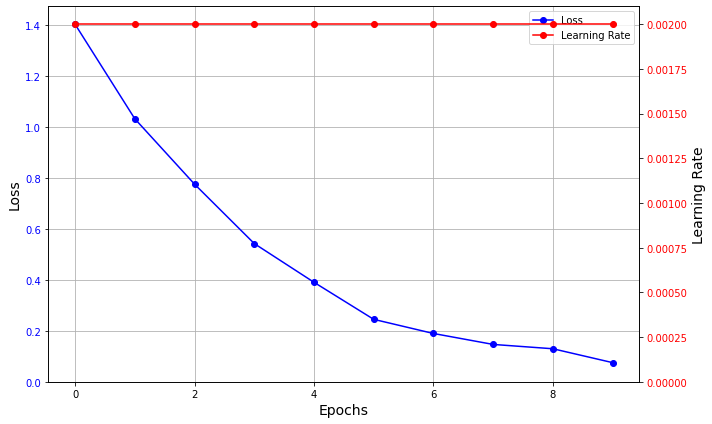

In [55]:
# Training
train_dataloader = DataLoader(master_dataset_franka, batch_size=batch_size, shuffle=True)

lrs = [0.04, 0.002]
lr_threshold = 0.0005
for ii in [1]:#range(len(models)):
    model = models[ii]
    #model.lstm.flatten_parameters()
    
    lr = lrs[ii]
    print('-----------------------------   ', models_names[ii],'----------------------------- ')
    #  training on source robot
    #model, loss_seq, lr_seq = train_loop(model, train_datasetloader,selected_features, lr, n_epochs[ii])
    model.train()
    # Use Adam optimizer and CrossEntropyLoss as the loss function
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)
    # Initialize learning rate scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=1, verbose=True)
    loss_seq = []
    lr_seq = []
    # Training loop
    for epoch in range(n_epochs[ii]):
        running_loss = []
        
        for X_batch, y_batch in train_dataloader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device) # Move data to device
            mask = y_batch != 0
            X_batch= X_batch[mask]
            y_batch= y_batch[mask]
            optimizer.zero_grad()
            # Generate noise and shift as PyTorch tensors
            y_pred = model(X_batch)
            
            y_batch = create_hierarchical_labels(y_batch, dof)
            loss = loss_fn(y_pred, y_batch)
            
            loss.backward()
            optimizer.step()
            running_loss.append(loss.cpu().detach().numpy())

        avg_loss = np.mean(running_loss)
        print(f"Epoch: {epoch + 1}/{n_epochs} - learning rate: {optimizer.param_groups[0]['lr']:.5f}, classification loss: {avg_loss:.4f}")
        # Update the scheduler with the average loss
        scheduler.step(avg_loss)
        current_lr = optimizer.param_groups[0]['lr']
        if current_lr < lr_threshold:
            print(f"Learning rate has dropped below the threshold of {lr_threshold}. Stopping training.")
            break
        loss_seq.append(avg_loss)
        lr_seq.append(current_lr)
        if avg_loss < 0.085:
            print('early stopping!')
            break

    plot_loss(loss_seq, lr_seq)
     
    # Validation
    #pre_training_accuracies = validation(test_dataloaders, dataloaders_names, model)
    #print(pre_training_accuracies)

## plot

In [56]:
# Testing
dataset_info = {
    #os.getcwd().replace('AIModels', '') + '/dataset/franka_main/labeled_data/': 7,
    os.getcwd().replace('AIModels', '') + '/dataset/ur5/labeled_data/': 6,
    os.getcwd().replace('AIModels', '') + '/dataset/franka_mindlab/labeled_data/': 7
}
dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(7)]#+[ f'de{i}' for i in range(robot_dof)]

n = 14  # Window size for majority voting

model = models[1].eval()

# Loop through each dataset path and corresponding dof
for data_path, dof in dataset_info.items():
    print(data_path)
    # Load the dataset for testing
    testing_datasets = LoadDatasets(data_path, dict_label)
    test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=False)
    links = ['link7', 'link6', 'link5', 'link4', 'link3', 'link2', 'link1']
    for link in links:
        # Iterate through the dataset (trials)
        for trial_dataset_path, label in test_datasetloader:
            if link in trial_dataset_path[0]:
                # Load the dataset for the specific trial
                data = LoadSeqDataset(file_path=trial_dataset_path[0], label=label[0], 
                                    selected_features=selected_features[0:dof], seq_num=seq_num, gap=1)

                # Initialize an empty dataframe if not done before
                df = pd.DataFrame(columns=["time", "label", "model_out", "probability", "majority_voting"])

                # Create a DataLoader for this specific trial data
                test_loader = DataLoader(data, batch_size=len(data), shuffle=False)

                # Iterate through the DataLoader to make predictions
                for batch_idx, (seqs, labels) in enumerate(test_loader):
                    seqs = seqs.float().to(device)  # Convert sequences to float and move to device

                    # Perform the prediction without gradient computation
                    with torch.no_grad():
                        predictions = model.prediction(seqs)

                    # Fill the dataframe with the results
                    df['time'] = data.data.time[seq_num - 1:-1]
                    df['label'] = labels.cpu().numpy()  # Convert label to numpy
                    df['model_out'] = predictions.cpu().detach().numpy()  # Convert predictions to numpy
                    mask = df.label == 0
                    df.model_out[mask]=0
                    df['majority_voting'] = majority_voting_last_n(df['model_out'], n)

                # Plotting using Plotly (assuming you have plotly installed)
                df.iplot(x='time', y=['model_out', 'majority_voting', 'label'], 
                        colors=[ 'lightblue', 'darkblue', 'red'], 
                        title='Link ' + str(labels.max().item()))
                break
    break

/home/rzma/myProjects/contactInterpretation//dataset/ur5/labeled_data/


# Training all models

In [11]:
# hyperparameters
import pickle, logging
accuracy_metric = Accuracy()

loss_fn = nn.CrossEntropyLoss()
loss_fn = nn.BCEWithLogitsLoss()
#loss_fn = nn.MultiLabelSoftMarginLoss()

lrs = [0.04, 0.002]
lr_threshold = 0.0005
n_epochs = [35, 20]
n = 14  # Window size for majority voting
batch_size = 62
data_name, dof = 'ur5', 6 #franka_main, ur5
split_rate =0.75
torch.manual_seed(2020)
np.random.seed(2020)
random.seed(2020)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if device.type == "cuda":
    print("Using GPU:", torch.cuda.get_device_name())

main_path = os.getcwd().replace('AIModels', '')
dataset_info = {os.getcwd().replace('AIModels', '') + f'/dataset/{data_name}/labeled_data/': dof}
logging.basicConfig(
    level=logging.INFO,  # Set the logging level to INFO
    format='%(asctime)s - %(levelname)s - %(message)s',
    handlers=[
        logging.StreamHandler(),  # Print log to console
        logging.FileHandler(os.getcwd() + f'/training_out/contact_localization/{data_name}_training_log_batch_size{batch_size}_{time.time()}.txt')#num_layers{num_layers}_hidden_size{hidden_size}.txt')  # Save log to a single file
    ]
)
dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(dof)]#+[ f'de{i}' for i in range(robot_dof)]


for num_layers in [1]:
    for hidden_size in [64, 128]:
        for seq_num in [80, 100]:#, 150, 200]:
            for gap in [3, 5]:#, 10, 15]:
                # Load the dataset from the file _half_0_75_0_3
                with open(f'{main_path}/dataset/{data_name}/pickleDatasets/{data_name}_feature_e_gap_{gap}_splitRate_{split_rate}_seqNum_{seq_num}.pickle', 'rb') as f:
                    master_dataset = pickle.load(f)

                # Training
                train_dataloader = DataLoader(master_dataset, batch_size=batch_size, shuffle=True)

                # Build the model
                #model_lstmBlock = lstmBlock(num_features_joints=seq_num, num_layers=num_layers, hidden_size=64, dropout=0.2, bidirectional=True)
                model_cnnLSTM = cnnLSTM(num_features_joints=seq_num, num_layers=num_layers, hidden_size=hidden_size, dropout=0.7, bidirectional=True)
                models = [model_cnnLSTM, model_cnnLSTM]
                models_names = ['model_lstmBlock',  'model_cnnLSTM',]
                for model in models:
                    model.to(device)
                    
                for ii in [1]:#range(len(models)):
                    model = models[ii]
                    #model.lstm.flatten_parameters()
                    
                    lr = lrs[ii]
                    logging.info(f'------------  {models_names[ii]} , num_layers = {num_layers}, hidden_size={hidden_size} seq_num = {seq_num}, gap = {gap}, --------------')
                    #  training on source robot
                    #model, loss_seq, lr_seq = train_loop(model, train_datasetloader,selected_features, lr, n_epochs[ii])
                    model.train()
                    # Use Adam optimizer and CrossEntropyLoss as the loss function
                    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)
                    # Initialize learning rate scheduler
                    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=1, verbose=True)
                    loss_seq = []
                    lr_seq = []
                    # Training loop
                    for epoch in range(n_epochs[ii]):
                        running_loss = []
                        
                        for X_batch, y_batch in train_dataloader:
                            X_batch, y_batch = X_batch.to(device), y_batch.to(device) # Move data to device
                            mask = y_batch != 0
                            X_batch = X_batch[mask]
                            y_batch = y_batch[mask]
                            if y_batch.shape[0]>0:
                                optimizer.zero_grad()
                                y_pred = model(X_batch)
                                y_batch = create_hierarchical_labels(y_batch, dof)
                                loss = loss_fn(y_pred, y_batch)            
                                loss.backward()
                                optimizer.step()
                                running_loss.append(loss.cpu().detach().numpy())

                        avg_loss = np.mean(running_loss)
                        #print(f"Epoch: {epoch + 1}/{n_epochs} - learning rate: {optimizer.param_groups[0]['lr']:.5f}, classification loss: {avg_loss:.4f}")
                        # Update the scheduler with the average loss
                        scheduler.step(avg_loss)
                        current_lr = optimizer.param_groups[0]['lr']
                        if current_lr < lr_threshold:
                            print(f"Learning rate has dropped below the threshold of {lr_threshold}. Stopping training.")
                            break
                        loss_seq.append(avg_loss)
                        lr_seq.append(current_lr)
                        if avg_loss < 0.08:
                            print('early stopping <0.08!')
                            break
                    #logging.info(f'loss = {loss_seq}')
                    #logging.info(f'lr = {lr_seq}')
                    model.eval()
                    os.makedirs(f'{main_path}/dataset/{data_name}/trained_models/contact_localization/{batch_size}/', exist_ok=True)
                    accuracies = []
                    # Loop through each dataset path and corresponding dof
                    for data_path, dof in dataset_info.items():
                        # Load the dataset for testing
                        testing_datasets = LoadDatasets(data_path, dict_label)
                        test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=False)
                        
                        for trial_dataset_path, label in test_datasetloader:
                            if 'link1' in trial_dataset_path[0]:
                                # Load the dataset for the specific trial
                                data = LoadSeqDataset(file_path=trial_dataset_path[0], label=label[0], 
                                                    selected_features=selected_features, seq_num=seq_num, gap=1)
                                data.sequences = data.sequences[len(data)//2:-1]
                                # Initialize an empty dataframe if not done before
                                df = pd.DataFrame(columns=["time", "label", "model_out", "probability", "majority_voting"])

                                # Create a DataLoader for this specific trial data
                                test_loader = DataLoader(data, batch_size=len(data), shuffle=False)

                                # Iterate through the DataLoader to make predictions
                                for batch_idx, (seqs, labels) in enumerate(test_loader):
                                    seqs = seqs.float().to(device)  # Convert sequences to float and move to device

                                    # Perform the prediction without gradient computation
                                    with torch.no_grad():
                                        predictions = model(seqs)
                                        predictions = torch.argmax(predictions, dim=1) + 1

                                    # Fill the dataframe with the results
                                    df['time'] = data.data.time[len(data.data.time)-len(data)-1:-1]
                                    df['label'] = labels.cpu().numpy()  # Convert label to numpy
                                    df['model_out'] = predictions.cpu().detach().numpy()  # Convert predictions to numpy
                                    mask = df.label == 0
                                    df.model_out[mask]= 0
                                    df['majority_voting'] = majority_voting_last_n(df['model_out'], n)

                                # Plotting using Plotly (assuming you have plotly installed)
                                df.iplot(x='time', y=['model_out', 'majority_voting', 'label'], colors=[ 'lightblue', 'darkblue', 'red'], title='Link ' + str(labels.max().item()))
                                accuracy_metric.update(torch.tensor(df['majority_voting'].values), torch.tensor(df['label'].values))
                                accuracy = accuracy_metric.compute()
                                accuracies.append(accuracy.item()*100)
                                accuracy_metric.reset()

                                '''confmat = ConfusionMatrix(task="multiclass", num_classes=dof+1)
                                cm = confmat(torch.tensor(df['majority_voting'].values), torch.tensor(df['label'].values))
                                logging.info(f'\n{cm}')'''
                                break
                        logging.info(f'Accuracy on the test data = {accuracies}')
                        torch.save(model.state_dict(), f'{main_path}/dataset/{data_name}/trained_models/contact_localization/{batch_size}/numLayer{num_layers}_hiddenSize{hidden_size}_seq_num{seq_num}_gap{gap}_accuracy{accuracies[0]:.2f}')
                        break 

2025-01-29 17:44:53,133 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=64 seq_num = 80, gap = 3, --------------


Using GPU: Quadro RTX 8000
early stopping <0.08!


2025-01-29 17:45:01,423 - INFO - Accuracy on the test data = [83.95220041275024]
2025-01-29 17:45:01,463 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=64 seq_num = 80, gap = 5, --------------


early stopping <0.08!


2025-01-29 17:45:07,875 - INFO - Accuracy on the test data = [85.44601202011108]
2025-01-29 17:45:07,921 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=64 seq_num = 100, gap = 3, --------------


early stopping <0.08!


2025-01-29 17:45:15,806 - INFO - Accuracy on the test data = [86.75525188446045]
2025-01-29 17:45:15,848 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=64 seq_num = 100, gap = 5, --------------


early stopping <0.08!


2025-01-29 17:45:22,173 - INFO - Accuracy on the test data = [86.84097528457642]
2025-01-29 17:45:22,223 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=128 seq_num = 80, gap = 3, --------------


early stopping <0.08!


2025-01-29 17:45:29,940 - INFO - Accuracy on the test data = [87.19590306282043]
2025-01-29 17:45:29,978 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=128 seq_num = 80, gap = 5, --------------


early stopping <0.08!


2025-01-29 17:45:36,181 - INFO - Accuracy on the test data = [85.7020914554596]
2025-01-29 17:45:36,228 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=128 seq_num = 100, gap = 3, --------------


early stopping <0.08!


2025-01-29 17:45:43,656 - INFO - Accuracy on the test data = [87.05529570579529]
2025-01-29 17:45:43,697 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=128 seq_num = 100, gap = 5, --------------


early stopping <0.08!


2025-01-29 17:45:49,687 - INFO - Accuracy on the test data = [86.88384294509888]


## accuray calucation

In [72]:
from sklearn.metrics import classification_report, confusion_matrix
import logging
data_name, dof, batch_size = 'franka_main', 7 , 62


best_models_index, folder_name , data_name, dof  = ([   [1, 64, 3, 50],
                                                        [1, 64, 3, 80],
                                                        [1, 64, 3, 100],
                                                        [1, 64, 5, 50],
                                                        [1, 64, 5, 80],
                                                        [1, 64, 5, 100],
                                                        [1, 128, 3, 50],
                                                        [1, 128, 3, 80],
                                                        [1, 128, 3, 100],
                                                        [1, 128, 5, 50],
                                                        [1, 128, 5, 80],
                                                        [1, 128, 5, 100] ], f'{data_name}/trained_models/contact_localization/{batch_size}/', f'{data_name}', dof)

logging.info(f'trained model on {folder_name}, tested on {data_name}, with {dof} links')

#best_models_index = [[1, 128, 3, 80]]
# hyperparameters

n = 14  # Window size for majority voting

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if device.type == "cuda":
    print("Using GPU:", torch.cuda.get_device_name())

main_path = os.getcwd().replace('AIModels', '')


dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(dof)]#+[ f'de{i}' for i in range(robot_dof)]

# Load dataset ONCE outside the model loop
testing_datasets = LoadDatasets(os.getcwd().replace('AIModels', '') + f'/dataset/{data_name}/labeled_data/', dict_label)
test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=False)

file_predictions = {}
for link in dict_label.keys():
    for trial_dataset_path, label in test_datasetloader:
        if link in trial_dataset_path[0]:
            print(link)
            for num_layers, hidden_size, gap, seq_num in best_models_index:
                for model_name in os.listdir(f'{main_path}/dataset/{folder_name}/'):                   
                    if f'hiddenSize{hidden_size}_seq_num{seq_num}_gap{gap}' in model_name:
                        if model_name not in file_predictions:
                            file_predictions[model_name] = {'y_pred': [], 'y_true': []}
                        # Load and evaluate model
                        model = cnnLSTM(num_features_joints=seq_num, num_layers=num_layers, hidden_size=hidden_size, dropout=0.7, bidirectional=True)
                        model.to(device)
                        model.load_state_dict(torch.load(f'{main_path}/dataset/{folder_name}/{model_name}'))
                        model.eval()
                        data = LoadSeqDataset(
                            file_path=trial_dataset_path[0], label=label[0], 
                            selected_features=selected_features, seq_num=seq_num, gap=1
                        )
                        #data.sequences = data.sequences[len(data)//2:-1]
                        data.sequences = data.sequences[(len(data)-len(data)//2):-1]

                        test_loader = DataLoader(data, batch_size=len(data), shuffle=False)
                        # Run inference
                        df= pd.DataFrame()
                        for batch_idx, (seqs, labels) in enumerate(test_loader):
                            seqs = seqs.float().to(device)
                            with torch.no_grad():
                                predictions = model(seqs)
                                predictions = torch.argmax(predictions, dim=1) + 1

                            df['time'] = data.data.time[len(data.data.time)-len(data)-1:-1]
                            df['label'] = labels.cpu().numpy()
                            df['model_out'] = predictions.cpu().detach().numpy()
                            df.model_out[df.label == 0] = 0
                            df['majority_voting'] = majority_voting_last_n(df['model_out'], n)
                            
                        #df.iplot(x='time', y=['model_out', 'majority_voting', 'label'], colors=[ 'lightblue', 'darkblue', 'red'], title='Link ' + str(labels.max().item()))
                        # Collect predictions for current model
                        y_true_filtered = df.label[(df.label != 0) & (df.majority_voting != 0)].tolist()
                        y_pred_filtered = df.majority_voting[(df.label != 0) & (df.majority_voting != 0)].tolist()
                        file_predictions[model_name]['y_pred'].extend(y_pred_filtered)
                        file_predictions[model_name]['y_true'].extend(y_true_filtered)
                        break  # Process only first trial per link
                    
            break

for model_name in file_predictions.keys():
    y_pred = file_predictions[model_name]['y_pred']
    y_true = file_predictions[model_name]['y_true']
    matrix = confusion_matrix(y_pred=y_pred, y_true=y_true)

    total_samples = sum(sum(row) for row in matrix)
    logging.info(f'{model_name}, total samples: {total_samples}')
    #logging.info(f'\n {matrix}')
    true_positives = sum(matrix[i][i] for i in range(len(matrix)))

    overall_accuracy = (true_positives / total_samples) * 100
    failure_rate = [(sum(matrix[i]) - matrix[i][i]) / sum(matrix[i]) * 100 for i in range(len(matrix))]
    logging.info(f'acuracy= {overall_accuracy}, detection failure (links): {failure_rate}')


2025-01-29 23:21:23,421 - INFO - trained model on franka_main/trained_models/contact_localization/62/, tested on franka_main, with 7 links


Using GPU: Quadro RTX 8000
link7
link6
link5
link4
link3
link2
link1


2025-01-29 23:22:37,910 - INFO - numLayer1_hiddenSize64_seq_num80_gap3_accuracy91.68, total samples: 3968
2025-01-29 23:22:37,911 - INFO - acuracy= 97.25302419354838, detection failure (links): [0.0, 0.7763975155279503, 0.0, 1.0570824524312896, 15.160796324655438, 0.0, 0.0]
2025-01-29 23:22:37,915 - INFO - numLayer1_hiddenSize64_seq_num100_gap3_accuracy80.91, total samples: 3969
2025-01-29 23:22:37,915 - INFO - acuracy= 89.64474678760394, detection failure (links): [22.126929674099486, 0.0, 2.0599250936329585, 0.0, 41.56441717791411, 0.0, 0.0]
2025-01-29 23:22:37,918 - INFO - numLayer1_hiddenSize64_seq_num80_gap5_accuracy91.13, total samples: 3969
2025-01-29 23:22:37,919 - INFO - acuracy= 97.02695893172084, detection failure (links): [0.5059021922428331, 3.400309119010819, 0.0, 18.580375782881003, 0.0, 0.0, 0.8733624454148471]
2025-01-29 23:22:37,923 - INFO - numLayer1_hiddenSize64_seq_num100_gap5_accuracy91.85, total samples: 3976
2025-01-29 23:22:37,923 - INFO - acuracy= 99.019114688

## plots

In [9]:
from sklearn.metrics import classification_report, confusion_matrix

data_name, dof = 'ur5', 6 #franka_main, ur5

best_models_index, batch_size, folder_name , data_name, dof  = ([   [1, 64, 3, 50],
                                                                    [1, 64, 3, 80],
                                                                    [1, 64, 3, 100],
                                                                    [1, 64, 5, 50],
                                                                    [1, 64, 5, 80],
                                                                    [1, 64, 5, 100],
                                                                    [1, 128, 3, 50],
                                                                    [1, 128, 3, 80],
                                                                    [1, 128, 3, 100],
                                                                    [1, 128, 5, 50],
                                                                    [1, 128, 5, 80],
                                                                    [1, 128, 5, 100] ], 64, 'contact_localization/67/', data_name, dof)


#best_models_index = [[2, 128, 3, 200]]
# hyperparameters

n = 14  # Window size for majority voting

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if device.type == "cuda":
    print("Using GPU:", torch.cuda.get_device_name())

main_path = os.getcwd().replace('AIModels', '')

dataset_info = {
os.getcwd().replace('AIModels', '') + f'/dataset/{data_name}/labeled_data/': dof
}

dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(dof)]#+[ f'de{i}' for i in range(robot_dof)]


counter = 1
links = ['link7', 'link6', 'link5', 'link4', 'link3', 'link2', 'link1']
for num_layers, hidden_size, gap, seq_num in best_models_index:
    for model_name in os.listdir(f'{main_path}/dataset/{data_name}/trained_models/{folder_name}/'):
        if f'hiddenSize{hidden_size}_seq_num{seq_num}_gap{gap}' in model_name:
            print(counter,')  ' , num_layers, hidden_size, gap, seq_num)
            counter +=1
            model = cnnLSTM(num_features_joints=seq_num, num_layers=num_layers, hidden_size=hidden_size, dropout=0.7, bidirectional=True)
            model.to(device)
            model.load_state_dict(torch.load(f'{main_path}/dataset/{data_name}/trained_models/{folder_name}/{model_name}'))
            model.eval()
            y_pred, y_true= [], []

            for data_path, dof in dataset_info.items():
                # Load the dataset for testing
                testing_datasets = LoadDatasets(data_path, dict_label)
                test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=False)
                y_true, y_pred = [], []
                for link in links:
                    # Iterate through the dataset (trials)
                    for trial_dataset_path, label in test_datasetloader:
                        if link in trial_dataset_path[0]:
                            # Load the dataset for the specific trial
                            data = LoadSeqDataset(file_path=trial_dataset_path[0], label=label[0], 
                                                selected_features=selected_features[0:dof], seq_num=seq_num, gap=1)
                            data.sequences = data.sequences[len(data)//2:-1]
                            # Initialize an empty dataframe if not done before
                            df = pd.DataFrame(columns=["time", "label", "model_out", "probability", "majority_voting"])

                            # Create a DataLoader for this specific trial data
                            test_loader = DataLoader(data, batch_size=len(data), shuffle=False)

                            # Iterate through the DataLoader to make predictions
                            for batch_idx, (seqs, labels) in enumerate(test_loader):
                                seqs = seqs.float().to(device)  # Convert sequences to float and move to device

                                # Perform the prediction without gradient computation
                                with torch.no_grad():
                                    predictions = model(seqs)
                                    predictions = torch.argmax(predictions, dim=1)+1

                                # Fill the dataframe with the results
                                df['time'] = data.data.time[len(data.data.time)-len(data)-1:-1]
                                df['label'] = labels.cpu().numpy()  # Convert label to numpy
                                df['model_out'] = predictions.cpu().detach().numpy()  # Convert predictions to numpy
                                df.model_out[df.label==0] = 0
                                df['majority_voting'] = majority_voting_last_n(df['model_out'], n)

                            # Plotting using Plotly (assuming you have plotly installed)
                            df.iplot(x='time', y=['model_out', 'majority_voting', 'label'], 
                                    colors=[ 'lightblue', 'darkblue', 'red'], 
                                    title=f'{link}_{model_name}')
                            y_true = y_true + df.label[(df.label != 0) & (df.majority_voting != 0)].tolist()
                            y_pred = y_pred + df.majority_voting[(df.label != 0) & (df.majority_voting != 0)].tolist()

                            

                            break
                # Pass to sklearn safely
                cm = confusion_matrix(y_pred=y_pred, y_true=y_true)
                print(cm)
                #logging.info(f'Testing {hidden_size},{gap}, {seq_num}, {model_name}, total classified samples:{sum(sum(cm))}')
                #logging.info(f'\n{cm}')

Using GPU: Quadro RTX 8000
1 )   1 64 3 50


[[403  98  30  36   1  12]
 [162 361  97  84   0  21]
 [160  59 516 182  77  10]
 [132  82 163 233  40  16]
 [ 21   0 101  17 516   7]
 [153 218  31 157  44 184]]
2 )   1 64 3 80


[[431  89  40  13   0   0]
 [251 401  40  21   0   3]
 [ 54  49 579 140 158  23]
 [ 80 134 152 161  76  56]
 [ 11   3 109  61 464  19]
 [160 227  70  42   9 283]]
3 )   1 64 5 50


[[413  85  54   2   0  23]
 [223 407  35  33  11  18]
 [194  35 307 363  69  31]
 [ 73 175 130 175  54  53]
 [ 24   4  59 132 439   0]
 [193 231  47  66  31 227]]


# 4. Transfer Learning

In [33]:
# load target data
data_path, robot_dof = (os.getcwd().replace('AIModels','') +'/dataset/franka_mindlab/labeled_data/', 7)
#data_path, robot_dof = (os.getcwd().replace('AIModels','') +'/dataset/ur5/labeled_data/', 6)
dict_label  = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}

'''seq_num = 64
gap = 5'''
selected_features = [f'e{i}' for i in range(robot_dof)]#+[ f'de{i}' for i in range(robot_dof)]


# Load data and create training and testing sets

testing_datasets = LoadDatasets(data_path, dict_label)
test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=True)

# Initialize counters
total_samples_counter = 0
train_samples_counter = 0
master_dataset = []

# Iterate through test_datasetloader
for trial_dataset_path, label in test_datasetloader:
    # Load the dataset for the trial
    data = LoadSeqDataset(file_path=trial_dataset_path[0], label=label[0], selected_features=selected_features, seq_num=seq_num, gap=gap)

    ''' # Count total samples
    total_samples = len(data)
    total_samples_counter += total_samples

    # Calculate number of samples for the subset (5% of the data)
    num_samples = int(0.2 * total_samples)
    train_samples_counter += num_samples

    # Randomly sample indices
    indices = torch.randperm(total_samples).tolist()[:num_samples]

    # Create a subset of the data
    subset_data = Subset(data, indices)'''
    
    # Count total samples
    total_samples = len(data)
    total_samples_counter += total_samples

    data.balanceData(split_rate_1=0.7, split_rate_0=0.07)
    # Calculate number of samples for the subset (5% of the data)
    num_samples = len(data)
    train_samples_counter += num_samples
    master_dataset.append(data)

# Combine all subsets into a single dataset
master_dataset_ur5 = ConcatDataset(master_dataset)

# Create a DataLoader for the combined dataset
train_dataloader = DataLoader(master_dataset_ur5, batch_size=batch_size, shuffle=True)

unique_labels, counts = 0 , 0
for X_batch, y_batch in train_dataloader:
    unique_labels, b = y_batch.unique(return_counts=True)
    counts += b
print(f"Total samples across all trials: {total_samples_counter}")
print(f"Total samples used for training ({train_samples_counter//total_samples_counter*100}% of data): {train_samples_counter}")
print(f"Unique labels: {unique_labels}")
print(f"Counts: {counts}")
print(f"Batch shape: {y_batch.shape}")

RuntimeError: The size of tensor a (8) must match the size of tensor b (5) at non-singleton dimension 0

## Fine Tuning

-----------------------------    model_cnnLSTM ----------------------------- 
Epoch: 1/[25, 10] - learning rate: 0.00100, classification loss: 0.2478
Epoch: 2/[25, 10] - learning rate: 0.00100, classification loss: 0.1268
Epoch: 3/[25, 10] - learning rate: 0.00100, classification loss: 0.0729
Epoch: 4/[25, 10] - learning rate: 0.00100, classification loss: 0.0407
Epoch: 5/[25, 10] - learning rate: 0.00100, classification loss: 0.0256
Epoch: 6/[25, 10] - learning rate: 0.00100, classification loss: 0.0159
Epoch: 7/[25, 10] - learning rate: 0.00100, classification loss: 0.0103
Epoch: 8/[25, 10] - learning rate: 0.00100, classification loss: 0.0087
Epoch: 9/[25, 10] - learning rate: 0.00100, classification loss: 0.0075
Epoch: 10/[25, 10] - learning rate: 0.00100, classification loss: 0.0089


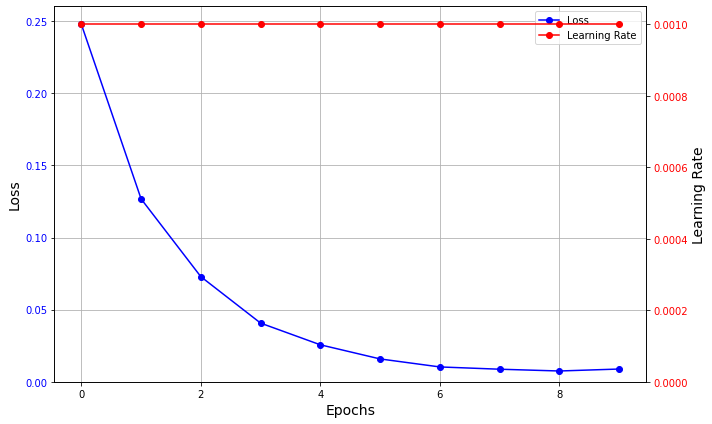

In [45]:
# training
train_dataloader = DataLoader(master_dataset_ur5, batch_size=batch_size, shuffle=True)

models_da = copy.deepcopy(models)

n_epochs = [25, 10]
lrs = [0.01, 0.001]

lr_threshold = 0.0005

for ii in [1]:#range(len(models)):
    model = models_da[ii]
    #model.lstm.flatten_parameters()
    
    lr = lrs[ii]
    print('-----------------------------   ', models_names[ii],'----------------------------- ')
    #  training on source robot
    #model, loss_seq, lr_seq = train_loop(model, train_datasetloader,selected_features, lr, n_epochs[ii])
    model.train()
    # Use Adam optimizer and CrossEntropyLoss as the loss function
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)
    # Initialize learning rate scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=1, verbose=True)
    loss_seq = []
    lr_seq = []
    # Training loop
    for epoch in range(n_epochs[ii]):
        running_loss = []
        
        for X_batch, y_batch in train_dataloader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device) # Move data to device
            optimizer.zero_grad()
            # Generate noise and shift as PyTorch tensors
            y_pred = model(X_batch, freeze_last_layer = True)
            y_batch = create_hierarchical_labels(y_batch, robot_dof)
            loss = loss_fn(y_pred, y_batch)
            
            loss.backward()
            optimizer.step()
            running_loss.append(loss.cpu().detach().numpy())

        avg_loss = np.mean(running_loss)
        print(f"Epoch: {epoch + 1}/{n_epochs} - learning rate: {optimizer.param_groups[0]['lr']:.5f}, classification loss: {avg_loss:.4f}")
        # Update the scheduler with the average loss
        scheduler.step(avg_loss)
        current_lr = optimizer.param_groups[0]['lr']
        if current_lr < lr_threshold:
            print(f"Learning rate has dropped below the threshold of {lr_threshold}. Stopping training.")
            break
        loss_seq.append(avg_loss)
        lr_seq.append(current_lr)

    plot_loss(loss_seq, lr_seq)
     

In [35]:
# Testing
dataset_info = {
    os.getcwd().replace('AIModels', '') + '/dataset/franka_mindlab/labeled_data/': 7,
    os.getcwd().replace('AIModels', '') + '/dataset/ur5/labeled_data/': 6,
    os.getcwd().replace('AIModels', '') + '/dataset/franka_main/labeled_data/': 7
}
dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(7)]#+[ f'de{i}' for i in range(robot_dof)]

n = 14  # Window size for majority voting

model = models_da[1].eval()

# Loop through each dataset path and corresponding dof
for data_path, dof in dataset_info.items():
    print(data_path)
    # Load the dataset for testing
    testing_datasets = LoadDatasets(data_path, dict_label)
    test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=False)

    # Iterate through the dataset (trials)
    for trial_dataset_path, label in test_datasetloader:
        if 'link1' in trial_dataset_path[0]:
            # Load the dataset for the specific trial
            data = LoadSeqDataset(file_path=trial_dataset_path[0], label=label[0], 
                                selected_features=selected_features[0:dof], seq_num=seq_num, gap=1)

            # Initialize an empty dataframe if not done before
            df = pd.DataFrame(columns=["time", "label", "model_out", "probability", "majority_voting"])

            # Create a DataLoader for this specific trial data
            test_loader = DataLoader(data, batch_size=len(data), shuffle=False)

            # Iterate through the DataLoader to make predictions
            for batch_idx, (seqs, labels) in enumerate(test_loader):
                seqs = seqs.float().to(device)  # Convert sequences to float and move to device

                # Perform the prediction without gradient computation
                with torch.no_grad():
                    predictions = model.prediction(seqs)

                # Fill the dataframe with the results
                df['time'] = data.data.time[seq_num - 1:-1]
                df['label'] = labels.cpu().numpy()  # Convert label to numpy
                df['model_out'] = predictions.cpu().detach().numpy()  # Convert predictions to numpy
                df['majority_voting'] = majority_voting_last_n(df['model_out'], n)

            # Plotting using Plotly (assuming you have plotly installed)
            df.iplot(x='time', y=['model_out', 'majority_voting', 'label'], 
                    colors=[ 'lightblue', 'darkblue', 'red'], 
                    title='Link ' + str(labels.max().item()))
            break


/home/rzma/myProjects/contactInterpretation//dataset/franka_mindlab/labeled_data/


/home/rzma/myProjects/contactInterpretation//dataset/ur5/labeled_data/


/home/rzma/myProjects/contactInterpretation//dataset/franka_main/labeled_data/


## Fine Tuning All


In [47]:
accuracy_metric = Accuracy()
loss_fn = nn.MultiLabelSoftMarginLoss()
loss_fn = nn.BCEWithLogitsLoss()
#loss_fn = nn.CrossEntropyLoss()
lrs = [0.04, 0.002]
lr_threshold = 0.0001
n_epochs = [35, 20]
n = 14  # Window size for majority voting
best_models_index, folder_name, data_name, batch_size, dof = ([ [1, 64, 3, 50],
                                                                [1, 64, 3, 80],
                                                                [1, 64, 3, 100],
                                                                [1, 64, 5, 50],
                                                                [1, 64, 5, 80],
                                                                [1, 64, 5, 100],
                                                                [1, 128, 3, 50],
                                                                [1, 128, 3, 80],
                                                                [1, 128, 3, 100],
                                                                [1, 128, 5, 50],
                                                                [1, 128, 5, 80],
                                                                [1, 128, 5, 100] ], f'franka_main/trained_models/contact_localization/{batch_size}/', 'ur5', batch_size, 6)

logging.info(f'fine-tuning {folder_name} on {data_name} with {dof} links')
torch.manual_seed(2020)
np.random.seed(2020)
random.seed(2020)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if device.type == "cuda":
    print("Using GPU:", torch.cuda.get_device_name())

main_path = os.getcwd().replace('AIModels', '')
dataset_info = {os.getcwd().replace('AIModels', '') + f'/dataset/{data_name}/labeled_data/': dof}
logging.basicConfig(
    level=logging.INFO,  # Set the logging level to INFO
    format='%(asctime)s - %(levelname)s - %(message)s',
    handlers=[
        logging.StreamHandler(),  # Print log to console
        logging.FileHandler(os.getcwd() + f'/training_out/Fine_tuning_{data_name}_training_log_batch_size{batch_size}.txt')#num_layers{num_layers}_hidden_size{hidden_size}.txt')  # Save log to a single file
    ]
)
dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(dof)]#+[ f'de{i}' for i in range(robot_dof)]

for num_layers, hidden_size, gap, seq_num in best_models_index:
        # Load the dataset from the file _half__1_0_3
        with open(f'{main_path}/dataset/{data_name}/pickleDatasets/{data_name}_feature_e_gap_{gap}_splitRate_{split_rate}_seqNum_{seq_num}.pickle', 'rb') as f:
            master_dataset = pickle.load(f)
    
        # Training
        train_dataloader = DataLoader(master_dataset, batch_size=batch_size, shuffle=True)

        for model_name in os.listdir(f'{main_path}/dataset/{folder_name}/'):
            if f'numLayer{num_layers}_hiddenSize{hidden_size}_seq_num{seq_num}_gap{gap}' in model_name:
                # Build the model
                print(model_name)
                model = cnnLSTM(num_features_joints=seq_num, num_layers=num_layers, hidden_size=hidden_size, dropout=0.7, bidirectional=True)
                model.to(device)
                model.load_state_dict(torch.load(f'{main_path}/dataset/{folder_name}/{model_name}'))
                model.train()
                    
                lr = lrs[1]
                logging.info(f'------------  {models_names[ii]} , num_layers = {num_layers}, hidden_size={hidden_size} seq_num = {seq_num}, gap = {gap}, --------------')
                optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)
                scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=1, verbose=True)
                loss_seq = []
                lr_seq = []
                # Training loop
                for epoch in range(n_epochs[1]):
                    running_loss = []
                    
                    for X_batch, y_batch in train_dataloader:
                        X_batch, y_batch = X_batch.to(device), y_batch.to(device) # Move data to device
                        mask = y_batch !=0
                        y_batch = y_batch[mask]
                        X_batch = X_batch[mask]
                        if y_batch.shape[0] >0 :
                            optimizer.zero_grad()
                            y_pred = model(X_batch)
                            y_batch = create_hierarchical_labels(y_batch, dof)
                            loss = loss_fn(y_pred, y_batch)            
                            loss.backward()
                            optimizer.step()
                            running_loss.append(loss.cpu().detach().numpy())

                    avg_loss = np.mean(running_loss)
                    print(f"Epoch: {epoch + 1}/{n_epochs} - learning rate: {optimizer.param_groups[0]['lr']:.5f}, classification loss: {avg_loss:.4f}")
                    # Update the scheduler with the average loss
                    scheduler.step(avg_loss)
                    current_lr = optimizer.param_groups[0]['lr']
                    if current_lr < lr_threshold:
                        print(f"Learning rate has dropped below the threshold of {lr_threshold}. Stopping training.")
                        break
                    loss_seq.append(avg_loss)
                    lr_seq.append(current_lr)
                    if avg_loss < 0.08:
                        print('early stopping <0.08!')
                        break
                #logging.info(f'loss = {loss_seq}')
                #logging.info(f'lr = {lr_seq}')
                model.eval()
                os.makedirs(f'{main_path}/dataset/{data_name}/trained_models/contact_localization/fine_tuned{batch_size}/', exist_ok=True)
                accuracies = []
                # Loop through each dataset path and corresponding dof
                for data_path, dof in dataset_info.items():
                    # Load the dataset for testing
                    testing_datasets = LoadDatasets(data_path, dict_label)
                    test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=False)
                    
                    for trial_dataset_path, label in test_datasetloader:
                        if 'link1' in trial_dataset_path[0]:
                            # Load the dataset for the specific trial
                            data = LoadSeqDataset(file_path=trial_dataset_path[0], label=label[0], 
                                                selected_features=selected_features[0:dof], seq_num=seq_num, gap=1)
                            data.sequences = data.sequences[(len(data)-len(data)//2):len(data)]
                            # Initialize an empty dataframe if not done before
                            df = pd.DataFrame(columns=["time", "label", "model_out", "probability", "majority_voting"])

                            # Create a DataLoader for this specific trial data
                            test_loader = DataLoader(data, batch_size=len(data), shuffle=False)

                            # Iterate through the DataLoader to make predictions
                            for batch_idx, (seqs, labels) in enumerate(test_loader):
                                seqs = seqs.float().to(device)  # Convert sequences to float and move to device

                                # Perform the prediction without gradient computation
                                with torch.no_grad():
                                    predictions = model(seqs)
                                    predictions = torch.argmax(predictions, dim=1)+1

                                # Fill the dataframe with the results
                                df['time'] = data.data.time[len(data.data.time)-len(data)-1:-1]
                                df['label'] = labels.cpu().numpy()  # Convert label to numpy
                                df['model_out'] = predictions.cpu().detach().numpy()  # Convert predictions to numpy
                                df.model_out[df.label==0] = 0
                                df['majority_voting'] = majority_voting_last_n(df['model_out'], n)

                            # Plotting using Plotly (assuming you have plotly installed)
                            df.iplot(x='time', y=['model_out', 'majority_voting', 'label'], colors=[ 'lightblue', 'darkblue', 'red'], title='Link ' + str(labels.max().item()))
                            accuracy_metric.update(torch.tensor(df['majority_voting'].values), torch.tensor(df['label'].values))
                            accuracy = accuracy_metric.compute()
                            accuracies.append(accuracy.item()*100)
                            accuracy_metric.reset()

                            '''confmat = ConfusionMatrix(task="multiclass", num_classes=dof+1)
                            cm = confmat(torch.tensor(df['majority_voting'].values), torch.tensor(df['label'].values))
                            logging.info(f'\n{cm}')'''
                            break
                    logging.info(f'Accuracy on the test data = {accuracies}')
                    torch.save(model.state_dict(), f'{main_path}/dataset/{data_name}/trained_models/contact_localization/fine_tuned{batch_size}/numLayer{num_layers}_hiddenSize{hidden_size}_seq_num{seq_num}_gap{gap}_accuracy{accuracies[0]:.2f}')
                    break 

2025-01-29 21:03:58,861 - INFO - fine-tuning franka_main/trained_models/contact_localization/62/ on ur5 with 6 links
2025-01-29 21:03:58,957 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=64 seq_num = 80, gap = 3, --------------


Using GPU: Quadro RTX 8000
numLayer1_hiddenSize64_seq_num80_gap3_accuracy91.68
Epoch: 1/[35, 20] - learning rate: 0.00200, classification loss: 0.3688
Epoch: 2/[35, 20] - learning rate: 0.00200, classification loss: 0.1571
Epoch: 3/[35, 20] - learning rate: 0.00200, classification loss: 0.0983
Epoch: 4/[35, 20] - learning rate: 0.00200, classification loss: 0.0692
early stopping <0.08!


2025-01-29 21:04:04,642 - INFO - Accuracy on the test data = [85.48868894577026]
2025-01-29 21:04:04,706 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=64 seq_num = 100, gap = 3, --------------


numLayer1_hiddenSize64_seq_num100_gap3_accuracy80.91
Epoch: 1/[35, 20] - learning rate: 0.00200, classification loss: 0.3281
Epoch: 2/[35, 20] - learning rate: 0.00200, classification loss: 0.1243
Epoch: 3/[35, 20] - learning rate: 0.00200, classification loss: 0.0750
early stopping <0.08!


2025-01-29 21:04:09,584 - INFO - Accuracy on the test data = [84.0120017528534]
2025-01-29 21:04:09,657 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=64 seq_num = 80, gap = 5, --------------


numLayer1_hiddenSize64_seq_num80_gap5_accuracy91.13
Epoch: 1/[35, 20] - learning rate: 0.00200, classification loss: 0.4064
Epoch: 2/[35, 20] - learning rate: 0.00200, classification loss: 0.2084
Epoch: 3/[35, 20] - learning rate: 0.00200, classification loss: 0.1334
Epoch: 4/[35, 20] - learning rate: 0.00200, classification loss: 0.1021
Epoch: 5/[35, 20] - learning rate: 0.00200, classification loss: 0.0733
early stopping <0.08!


2025-01-29 21:04:14,429 - INFO - Accuracy on the test data = [89.20187950134277]
2025-01-29 21:04:14,482 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=64 seq_num = 100, gap = 5, --------------


numLayer1_hiddenSize64_seq_num100_gap5_accuracy91.85
Epoch: 1/[35, 20] - learning rate: 0.00200, classification loss: 0.4241
Epoch: 2/[35, 20] - learning rate: 0.00200, classification loss: 0.1993
Epoch: 3/[35, 20] - learning rate: 0.00200, classification loss: 0.1244
Epoch: 4/[35, 20] - learning rate: 0.00200, classification loss: 0.0793
early stopping <0.08!


2025-01-29 21:04:18,855 - INFO - Accuracy on the test data = [87.31247186660767]
2025-01-29 21:04:18,945 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=128 seq_num = 80, gap = 3, --------------


numLayer1_hiddenSize128_seq_num80_gap3_accuracy91.60
Epoch: 1/[35, 20] - learning rate: 0.00200, classification loss: 0.3157
Epoch: 2/[35, 20] - learning rate: 0.00200, classification loss: 0.1352
Epoch: 3/[35, 20] - learning rate: 0.00200, classification loss: 0.0818
Epoch: 4/[35, 20] - learning rate: 0.00200, classification loss: 0.0523
early stopping <0.08!


2025-01-29 21:04:24,432 - INFO - Accuracy on the test data = [84.37899947166443]
2025-01-29 21:04:24,493 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=128 seq_num = 100, gap = 3, --------------


numLayer1_hiddenSize128_seq_num100_gap3_accuracy91.61
Epoch: 1/[35, 20] - learning rate: 0.00200, classification loss: 0.3188
Epoch: 2/[35, 20] - learning rate: 0.00200, classification loss: 0.1110
Epoch: 3/[35, 20] - learning rate: 0.00200, classification loss: 0.0595
early stopping <0.08!


2025-01-29 21:04:29,314 - INFO - Accuracy on the test data = [86.19802594184875]
2025-01-29 21:04:29,386 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=128 seq_num = 80, gap = 5, --------------


numLayer1_hiddenSize128_seq_num80_gap5_accuracy91.52
Epoch: 1/[35, 20] - learning rate: 0.00200, classification loss: 0.4338
Epoch: 2/[35, 20] - learning rate: 0.00200, classification loss: 0.2089
Epoch: 3/[35, 20] - learning rate: 0.00200, classification loss: 0.1288
Epoch: 4/[35, 20] - learning rate: 0.00200, classification loss: 0.0869
Epoch: 5/[35, 20] - learning rate: 0.00200, classification loss: 0.0633
early stopping <0.08!


2025-01-29 21:04:34,231 - INFO - Accuracy on the test data = [86.42765879631042]
2025-01-29 21:04:34,282 - INFO - ------------  model_cnnLSTM , num_layers = 1, hidden_size=128 seq_num = 100, gap = 5, --------------


numLayer1_hiddenSize128_seq_num100_gap5_accuracy91.61
Epoch: 1/[35, 20] - learning rate: 0.00200, classification loss: 0.3773
Epoch: 2/[35, 20] - learning rate: 0.00200, classification loss: 0.1742
Epoch: 3/[35, 20] - learning rate: 0.00200, classification loss: 0.1081
Epoch: 4/[35, 20] - learning rate: 0.00200, classification loss: 0.0726
early stopping <0.08!


2025-01-29 21:04:38,601 - INFO - Accuracy on the test data = [84.69781279563904]


## accuracy

In [69]:
from sklearn.metrics import classification_report, confusion_matrix
#data_name, dof = 'franka_mindlab', 7
best_models_index, folder_name , data_name, dof  = ([   [1, 64, 3, 50],
                                                        [1, 64, 3, 80],
                                                        [1, 64, 3, 100],
                                                        [1, 64, 5, 50],
                                                        [1, 64, 5, 80],
                                                        [1, 64, 5, 100],
                                                        [1, 128, 3, 50],
                                                        [1, 128, 3, 80],
                                                        [1, 128, 3, 100],
                                                        [1, 128, 5, 50],
                                                        [1, 128, 5, 80],
                                                        [1, 128, 5, 100] ], f'contact_localization/fine_tuned{batch_size}/', data_name, dof)
logging.info(f'Fine-tuned source model with {data_name}, tested on {data_name}, with {dof} links')

#best_models_index = [[1, 128, 3, 100]]
# hyperparameters

n = 14  # Window size for majority voting

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if device.type == "cuda":
    print("Using GPU:", torch.cuda.get_device_name())

main_path = os.getcwd().replace('AIModels', '')


dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(dof)]#+[ f'de{i}' for i in range(robot_dof)]

# Load dataset ONCE outside the model loop
testing_datasets = LoadDatasets(os.getcwd().replace('AIModels', '') + f'/dataset/{data_name}/labeled_data/', dict_label)
test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=False)

file_predictions = {}
for link in dict_label.keys():
    for trial_dataset_path, label in test_datasetloader:
        if link in trial_dataset_path[0]:
            print(link)
            for num_layers, hidden_size, gap, seq_num in best_models_index:
                for model_name in os.listdir(f'{main_path}/dataset/{data_name}/trained_models/{folder_name}/'):                   
                    if f'hiddenSize{hidden_size}_seq_num{seq_num}_gap{gap}' in model_name:
                        if model_name not in file_predictions:
                            file_predictions[model_name] = {'y_pred': [], 'y_true': []}
                        # Load and evaluate model
                        model = cnnLSTM(num_features_joints=seq_num, num_layers=num_layers, hidden_size=hidden_size, dropout=0.7, bidirectional=True)
                        model.to(device)
                        model.load_state_dict(torch.load(f'{main_path}/dataset/{data_name}/trained_models/{folder_name}/{model_name}'))
                        model.eval()
                        data = LoadSeqDataset(
                            file_path=trial_dataset_path[0], label=label[0], 
                            selected_features=selected_features, seq_num=seq_num, gap=1
                        )
                        #data.sequences = data.sequences[len(data)//2:-1]
                        data.sequences = data.sequences[(len(data)-len(data)//2):-1]

                        test_loader = DataLoader(data, batch_size=len(data), shuffle=False)
                        # Run inference
                        df= pd.DataFrame()
                        for batch_idx, (seqs, labels) in enumerate(test_loader):
                            seqs = seqs.float().to(device)
                            with torch.no_grad():
                                predictions = model(seqs)
                                predictions = torch.argmax(predictions, dim=1) + 1

                            df['time'] = data.data.time[len(data.data.time)-len(data)-1:-1]
                            df['label'] = labels.cpu().numpy()
                            df['model_out'] = predictions.cpu().detach().numpy()
                            df.model_out[df.label == 0] = 0
                            df['majority_voting'] = majority_voting_last_n(df['model_out'], n)

                        # Collect predictions for current model
                        y_true_filtered = df.label[(df.label != 0) & (df.majority_voting != 0)].tolist()
                        y_pred_filtered = df.majority_voting[(df.label != 0) & (df.majority_voting != 0)].tolist()
                        file_predictions[model_name]['y_pred'].extend(y_pred_filtered)
                        file_predictions[model_name]['y_true'].extend(y_true_filtered)
                        break  # Process only first trial per link
            break

for model_name in file_predictions.keys():
    y_pred = file_predictions[model_name]['y_pred']
    y_true = file_predictions[model_name]['y_true']
    matrix = confusion_matrix(y_pred=y_pred, y_true=y_true)

    total_samples = sum(sum(row) for row in matrix)
    logging.info(f'{model_name}, total samples: {total_samples}')
    #logging.info(f'\n {matrix}')
    true_positives = sum(matrix[i][i] for i in range(len(matrix)))

    overall_accuracy = (true_positives / total_samples) * 100
    failure_rate = [(sum(matrix[i]) - matrix[i][i]) / sum(matrix[i]) * 100 for i in range(len(matrix))]
    logging.info(f'acuracy= {overall_accuracy}, detection failure (links): {failure_rate}')


2025-01-29 23:13:05,482 - INFO - Fine-tuned source model with franka_mindlab, tested on franka_mindlab, with 7 links


Using GPU: Quadro RTX 8000
link7
link6
link5
link4
link3
link2
link1


2025-01-29 23:15:01,527 - INFO - numLayer1_hiddenSize64_seq_num80_gap3_accuracy91.11, total samples: 5406
2025-01-29 23:15:01,528 - INFO - acuracy= 74.91675915649279, detection failure (links): [8.305274971941639, 59.849198868991515, 12.51360174102285, 24.360902255639097, 1.0849909584086799, 22.31075697211155, 34.751773049645394]
2025-01-29 23:15:01,533 - INFO - numLayer1_hiddenSize64_seq_num100_gap3_accuracy93.15, total samples: 5364
2025-01-29 23:15:01,533 - INFO - acuracy= 81.972408650261, detection failure (links): [3.192702394526796, 52.55198487712666, 9.170305676855897, 8.283132530120483, 0.7339449541284404, 20.3778677462888, 15.808170515097691]
2025-01-29 23:15:01,538 - INFO - numLayer1_hiddenSize64_seq_num80_gap5_accuracy90.17, total samples: 5398
2025-01-29 23:15:01,538 - INFO - acuracy= 77.06557984438682, detection failure (links): [10.135135135135135, 48.30827067669173, 25.543478260869566, 15.19756838905775, 0.18018018018018017, 23.200000000000003, 22.02486678507993]
2025-01

### plot


In [13]:

best_models_index, batch_size, folder_name , data_name, dof  = ([  [1, 64, 3, 80 ],
                                                                    [1, 128, 3, 30],
                                                                    [1, 128, 3, 50],
                                                                    [1, 128, 5, 80],
                                                                    [2, 128, 3, 50],
                                                                    [2, 128, 5, 50],
                                                                    [2, 128, 5, 80],
                                                                    [2, 128, 5, 100],
                                                                    [3, 64, 3, 50],
                                                                    [3,128, 3, 50],
                                                                    [3, 256, 5, 50]], 64, 'fine_tuned64', 'franka_mindlab', 7) # 0.2 of the no contact data

best_models_index, batch_size, folder_name , data_name, dof  = ([  [1, 64, 3, 50 ],
                                                                    [1, 128, 3, 50],
                                                                    [1, 256, 3, 30],
                                                                    [2, 64, 3, 30],
                                                                    [2, 128, 3, 80],
                                                                    [2, 356, 3, 50],
                                                                    [3, 64, 3, 50],
                                                                    [3,128, 3, 100],
                                                                    [3, 256, 3, 80]], 64, '64', 'franka_mindlab', 7) # 0.2 of the no contact data

'''best_models_index, batch_size, folder_name , data_name, dof  = ([  [1, 64, 3, 80 ],
                                                                    [1, 128, 3, 30],
                                                                    [1, 128, 3, 50],
                                                                    [1, 128, 5, 80],
                                                                    [2, 128, 3, 50],
                                                                    [2, 128, 5, 50],
                                                                    [2, 128, 5, 80],
                                                                    [2, 128, 5, 100],
                                                                    [3, 64, 3, 50],
                                                                    [3,128, 3, 50],
                                                                    [3, 256, 5, 50]], 64, 'fine_tuned64', 'ur5', 6) # 0.2 of the no contact data'''

best_models_index, batch_size, folder_name , data_name, dof  = ([  [1, 64, 3, 30 ],
                                                                    [1, 128, 5, 80],
                                                                    [1, 256, 5, 80],
                                                                    [2, 64, 3, 50],
                                                                    [2, 128, 3, 50],
                                                                    [2, 356, 3, 50],
                                                                    [3, 64, 3, 30],
                                                                    [3,128, 3, 30],
                                                                    [3, 256, 3, 100]], 64, '64', 'ur5', 6) # 0.2 of the no contact data

#best_models_index = [[2, 128, 3, 200]]
# hyperparameters

n = 14  # Window size for majority voting

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if device.type == "cuda":
    print("Using GPU:", torch.cuda.get_device_name())

main_path = os.getcwd().replace('AIModels', '')

dataset_info = {
os.getcwd().replace('AIModels', '') + f'/dataset/{data_name}/labeled_data/': 7
}

dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(dof)]#+[ f'de{i}' for i in range(robot_dof)]


counter = 1
links = ['link7', 'link6', 'link5', 'link4', 'link3', 'link2', 'link1']
for num_layers, hidden_size, gap, seq_num in best_models_index:
    for model_name in os.listdir(f'{main_path}/dataset/{data_name}/trained_models/{folder_name}/'):
        if f'numLayer{num_layers}_hiddenSize{hidden_size}_seq_num{seq_num}_gap{gap}' in model_name:
            print(counter,')  ' , num_layers, hidden_size, gap, seq_num)
            counter +=1
            model = cnnLSTM(num_features_joints=seq_num, num_layers=num_layers, hidden_size=hidden_size, dropout=0.7, bidirectional=True)
            model.to(device)
            model.load_state_dict(torch.load(f'{main_path}/dataset/{data_name}/trained_models/{folder_name}/{model_name}'))
            model.eval()
            y_pred, y_true= [], []

            for data_path, dof in dataset_info.items():
                # Load the dataset for testing
                testing_datasets = LoadDatasets(data_path, dict_label)
                test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=False)
                for link in links:
                    # Iterate through the dataset (trials)
                    for trial_dataset_path, label in test_datasetloader:
                        if link in trial_dataset_path[0]:
                            # Load the dataset for the specific trial
                            data = LoadSeqDataset(file_path=trial_dataset_path[0], label=label[0], 
                                                selected_features=selected_features[0:dof], seq_num=seq_num, gap=1)
                            data.sequences = data.sequences[len(data)//2:-1]
                            # Initialize an empty dataframe if not done before
                            df = pd.DataFrame(columns=["time", "label", "model_out", "probability", "majority_voting"])

                            # Create a DataLoader for this specific trial data
                            test_loader = DataLoader(data, batch_size=len(data), shuffle=False)

                            # Iterate through the DataLoader to make predictions
                            for batch_idx, (seqs, labels) in enumerate(test_loader):
                                seqs = seqs.float().to(device)  # Convert sequences to float and move to device

                                # Perform the prediction without gradient computation
                                with torch.no_grad():
                                    predictions = model.prediction(seqs)

                                # Fill the dataframe with the results
                                df['time'] = data.data.time[len(data.data.time)-len(data)-1:-1]
                                df['label'] = labels.cpu().numpy()  # Convert label to numpy
                                df['model_out'] = predictions.cpu().detach().numpy()  # Convert predictions to numpy
                                df['majority_voting'] = majority_voting_last_n(df['model_out'], n)

                            # Plotting using Plotly (assuming you have plotly installed)
                            df.iplot(x='time', y=['model_out', 'majority_voting', 'label'], 
                                    colors=[ 'lightblue', 'darkblue', 'red'], 
                                    title=f'{link}_{model_name}')
                            break

Using GPU: Quadro RTX 8000
1 )   1 64 3 30


KeyboardInterrupt: 

## Domain Adaptation

In [ ]:
#training
da_dataset =ConcatDataset([master_dataset_ur5, master_dataset_franka])
train_dataloader = DataLoader(da_dataset, batch_size=batch_size, shuffle=True)


models_da = copy.deepcopy(models)

n_epochs = [50, 10]
lrs = [0.04, 0.002]

lr_threshold = 0.0005

for ii in [1]:#range(len(models)):
    model = models_da[ii]
    #model.lstm.flatten_parameters()
    
    lr = lrs[ii]
    print('-----------------------------   ', models_names[ii],'----------------------------- ')
    #  training on source robot
    #model, loss_seq, lr_seq = train_loop(model, train_datasetloader,selected_features, lr, n_epochs[ii])
    dataset_loader = train_datasetloader
    model.train()
    # Use Adam optimizer and CrossEntropyLoss as the loss function
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)
    # Initialize learning rate scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=1, verbose=True)
    loss_seq = []
    lr_seq = []
    # Training loop
    for epoch in range(n_epochs[ii]):
        running_loss = []
        
        for X_batch, y_batch in train_dataloader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device) # Move data to device
            optimizer.zero_grad()
            # Generate noise and shift as PyTorch tensors
            y_pred = model(X_batch)
            y_batch = create_hierarchical_labels(y_batch, robot_dof)
            loss = loss_fn(y_pred, y_batch)
            
            loss.backward()
            optimizer.step()
            running_loss.append(loss.cpu().detach().numpy())

        avg_loss = np.mean(running_loss)
        print(f"Epoch: {epoch + 1}/{n_epochs} - learning rate: {optimizer.param_groups[0]['lr']:.5f}, classification loss: {avg_loss:.4f}")
        # Update the scheduler with the average loss
        scheduler.step(avg_loss)
        current_lr = optimizer.param_groups[0]['lr']
        if current_lr < lr_threshold:
            print(f"Learning rate has dropped below the threshold of {lr_threshold}. Stopping training.")
            break
        loss_seq.append(avg_loss)
        lr_seq.append(current_lr)

    plot_loss(loss_seq, lr_seq)
     

In [ ]:
# Testing
dataset_info = {
    os.getcwd().replace('AIModels', '') + '/dataset/franka_mindlab/labeled_data/': 7,
    os.getcwd().replace('AIModels', '') + '/dataset/ur5/labeled_data/': 6,
    os.getcwd().replace('AIModels', '') + '/dataset/franka_main/labeled_data/': 7
}
dict_label = {'link7': 7, 'link6':6, 'link5':5, 'link4':4, 'link3':3, 'link2':2, 'link1':1, 'no_contact': 0}
selected_features = [f'e{i}' for i in range(7)]#+[ f'de{i}' for i in range(robot_dof)]

n = 14  # Window size for majority voting

model = models_da[1].eval()

# Loop through each dataset path and corresponding dof
for data_path, dof in dataset_info.items():
    print(data_path)
    # Load the dataset for testing
    testing_datasets = LoadDatasets(data_path, dict_label)
    test_datasetloader = DataLoader(testing_datasets, batch_size=1, shuffle=False)

    # Iterate through the dataset (trials)
    for trial_dataset_path, label in test_datasetloader:
        if 'link2' in trial_dataset_path[0]:
            # Load the dataset for the specific trial
            data = LoadSeqDataset(file_path=trial_dataset_path[0], label=label[0], 
                                selected_features=selected_features[0:dof], seq_num=seq_num, gap=1)

            # Initialize an empty dataframe if not done before
            df = pd.DataFrame(columns=["time", "label", "model_out", "probability", "majority_voting"])

            # Create a DataLoader for this specific trial data
            test_loader = DataLoader(data, batch_size=len(data), shuffle=False)

            # Iterate through the DataLoader to make predictions
            for batch_idx, (seqs, labels) in enumerate(test_loader):
                seqs = seqs.float().to(device)  # Convert sequences to float and move to device

                # Perform the prediction without gradient computation
                with torch.no_grad():
                    predictions = model.prediction(seqs)

                # Fill the dataframe with the results
                df['time'] = data.data.time[seq_num - 1:-1]
                df['label'] = labels.cpu().numpy()  # Convert label to numpy
                df['model_out'] = predictions.cpu().detach().numpy()  # Convert predictions to numpy
                df['majority_voting'] = majority_voting_last_n(df['model_out'], n)

            # Plotting using Plotly (assuming you have plotly installed)
            df.iplot(x='time', y=['model_out', 'majority_voting', 'label'], 
                    colors=[ 'lightblue', 'darkblue', 'red'], 
                    title='Link ' + str(labels.max().item()))
            break


# Archive



## cross validation

In [ ]:
from sklearn.model_selection import KFold

n_epochs = [45, 55]
lrs = [0.04, 0.004]
lr_threshold = 0.0005

# Initialize cross-validation setup
kf = KFold(n_splits=5, shuffle=True, random_state=2020)
# Create a dataset and data loader for cross-validation
total_samples = len(master_dataset_franka)
indices = list(range(total_samples))

for ii in range(len(models)):
    highest_acc = 0
    lr = lrs[ii]
    print(f'-----------------------------   {models_names[ii]}   -----------------------------')

    # 5-fold cross-validation
    fold_accuracies = []

    for fold, (train_idx, val_idx) in enumerate(kf.split(indices)):
        model = copy.deepcopy(models[ii])

        print(f"Training fold {fold + 1}")

        # Split the data into train and validation sets
        train_subset = Subset(master_dataset_franka, train_idx)
        val_subset = Subset(master_dataset_franka, val_idx)

        # Create data loaders for the train and validation sets
        train_dataloader = DataLoader(train_subset, batch_size=batch_size, shuffle=True)
        val_dataloader = DataLoader(val_subset, batch_size=batch_size, shuffle=False)

        model.train()
        optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=1, verbose=True)

        loss_seq = []
        lr_seq = []

        # Training loop
        for epoch in range(n_epochs[ii]):
            running_loss = []

            for X_batch, y_batch in train_dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)
                optimizer.zero_grad()

                y_pred = model(X_batch)
                loss = loss_fn(y_pred, y_batch)

                loss.backward()
                optimizer.step()

                running_loss.append(loss.cpu().detach().numpy())

            avg_loss = np.mean(running_loss)
            #print(f"Epoch: {epoch + 1}/{n_epochs[ii]} - learning rate: {optimizer.param_groups[0]['lr']:.5f}, classification loss: {avg_loss:.4f}")
            scheduler.step(avg_loss)

            current_lr = optimizer.param_groups[0]['lr']
            if current_lr < lr_threshold:
                print(f"Learning rate has dropped below the threshold of {lr_threshold}. Stopping training.")
                break

            loss_seq.append(avg_loss)
            lr_seq.append(current_lr)

        plot_loss(loss_seq, lr_seq)

        # Validation loop
        model.eval()
        val_loss = 0.0
        correct_predictions = 0
        total_predictions = 0

        with torch.no_grad():
            for X_batch, y_batch in val_dataloader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)

                y_pred = model(X_batch)
                loss = loss_fn(y_pred, y_batch)

                val_loss += loss.item()

                # Calculate accuracy
                #_, predicted = torch.max(y_pred, 1)
                predicted, _ = model.prediction(X_batch)
                correct_predictions += (predicted == y_batch).sum().item()
                total_predictions += y_batch.size(0)

        avg_val_loss = val_loss / len(val_dataloader)
        val_accuracy = correct_predictions / total_predictions
        if val_accuracy > highest_acc :
            best_model = copy.deepcopy(model)
        print(f"Validation loss for fold {fold + 1}: {avg_val_loss:.4f}")
        print(f"Validation accuracy for fold {fold + 1}: {val_accuracy * 100:.2f}%")

        fold_accuracies.append(val_accuracy)

    # Calculate average accuracy across all folds
    avg_accuracy = np.mean(fold_accuracies)
    print(f"Average validation accuracy across all folds: {avg_accuracy * 100:.2f}%")

    # Optionally, plot performance
    plt.plot(fold_accuracies)
    plt.title('Fold Accuracies')
    plt.xlabel('Fold')
    plt.ylabel('Accuracy')
    plt.show()
    models[ii] = copy.deepcopy(best_model)


## tests

In [ ]:
data_path =  '/home/rzma/myProjects/contactInterpretation/dataset/ur5/labeled_data/link5/t2.csv'
import plotly.graph_objs as go
def get_features_dof(features, joint_number):
    j = joint_number
    feature_j = []
    for i in range(len(features)) :
        feature_j.append(f'{features[i]}{j}' )
    return feature_j


features = ['target_moment_', 'e_i', 'e', 'de']
features = ['e']
dof = 6
#features_num = len(features)*dof

window_length = seq_num

k_tau = np.array([0.1082, 0.1100, 0.1097, 0.0787, 0.0294, 0.0261])*13 #ur robot support file
#k_tau = [1.35,  1.361, 1.355, 0.957, 0.865, 0.893] #my finding
#k_tau = np.array([0.1155, 0.1149 , 0.0988, 0.1032, 0.1033, 0.1030])*10 #ur10e
e_i = [f'e_i{i}' for i in range(dof)]

testing_data = pd.read_csv(data_path)
for i in range(len(e_i)):
    testing_data[e_i[i]]=testing_data[e_i[i]]*k_tau[i]

testing_data['model_out'] = testing_data.label
testing_data['probability'] = testing_data.label
#testing_data = testing_data[testing_data.index > 4000]; testing_data.reset_index(inplace=True)
# trained with training set

for model_contact in models_da:
    model_contact.eval()

    for t_i in range(window_length, testing_data.shape[0]):
        #building data window
        window = []
        for joint_number in range(dof):
            feature_j = get_features_dof(features=features, joint_number=joint_number)
            joint_row = np.hstack(testing_data[feature_j][t_i-window_length:t_i].values)
            window.append(joint_row)
            
        #window = np.array(window)
        window = np.array([window])
        window_transformed = torch.tensor(window).to(device)
        with torch.no_grad():
            prediction, probability = model_contact.prediction(window_transformed.float())
            testing_data.loc[t_i-1, 'model_out'] = prediction.item()
            testing_data.loc[t_i-1, 'probability'] = probability.item()


    # Create traces for the first dataset
    traces = []
    traces.append(go.Scatter(x=testing_data['time'], y=testing_data['model_out'], mode='lines', name='model_out'))
    traces.append(go.Scatter(x=testing_data['time'], y=testing_data['probability'], mode='lines', name='probability'))
    traces.append(go.Scatter(x=testing_data['time'], y=testing_data['label'], mode='lines', name='label'))

    
    # Create the layout
    layout = go.Layout(
        title='Combined Plot',
        xaxis=dict(title='Time'),
        yaxis=dict(title='Values'),
        showlegend=True
    )

    # Create the figure and plot it
    fig = go.Figure(data=traces, layout=layout)
    fig.show()
    # calculate latency per contact event
    n = 80
    detection_delays = []
    true_label_index = testing_data.label[testing_data.label.diff()>0.9].index
    no_contact_start_index = testing_data.label[testing_data.label.diff()<-0.8].index
    no_contact_start_index = no_contact_start_index[no_contact_start_index>true_label_index[0]]

    predicted_label_index = testing_data.model_out[testing_data.model_out.diff()>0.9].index
    true_positive= np.zeros_like(true_label_index)
    counter = 0
    for i, end_i in zip(true_label_index, no_contact_start_index):
        state = False
        for j in range(end_i-i): 
            #if testing_data.model_out[i+j]:
            if (i+j) in predicted_label_index:
                detection_delays.append(testing_data.time[i+j]-testing_data.time[i])
                true_positive[counter]=1
                counter = counter +1
                state=True
                break
        if not state:
            true_positive[counter]=0
            counter = counter +1


    print('Single contact analysis')
    print(f'Correctly detected contacts(TP): {np.sum(true_positive)},   contact labels: {len(true_label_index)}, percision: {np.sum(true_positive)/len(true_label_index)} ')
    print(f'Effective Detection delay: {np.sum(detection_delays)/len(detection_delays):.3f} seconds')
    %matplotlib inline
    #plt.hist(detection_delays, bins=20)
    #plt.show()
    #plt.boxplot(detection_delays)
    

In [ ]:
data_path =  '/home/rzma/myProjects/contactInterpretation/dataset/ur5/labeled_data/link5/t2.csv'
import plotly.graph_objs as go
def get_features_dof(features, joint_number):
    j = joint_number
    feature_j = []
    for i in range(len(features)) :
        feature_j.append(f'{features[i]}{j}' )
    return feature_j


features = ['target_moment_', 'e_i', 'e', 'de']
features = ['e']
dof = 6
#features_num = len(features)*dof

window_length = seq_num

k_tau = np.array([0.1082, 0.1100, 0.1097, 0.0787, 0.0294, 0.0261])*13 #ur robot support file
#k_tau = [1.35,  1.361, 1.355, 0.957, 0.865, 0.893] #my finding
#k_tau = np.array([0.1155, 0.1149 , 0.0988, 0.1032, 0.1033, 0.1030])*10 #ur10e
e_i = [f'e_i{i}' for i in range(dof)]

testing_data = pd.read_csv(data_path)
for i in range(len(e_i)):
    testing_data[e_i[i]]=testing_data[e_i[i]]*k_tau[i]

testing_data['model_out'] = testing_data.label
testing_data['probability'] = testing_data.label
#testing_data = testing_data[testing_data.index > 4000]; testing_data.reset_index(inplace=True)
# trained with training set


for model_contact in models_da:
    model_contact.eval()

    for t_i in range(window_length, testing_data.shape[0]):
        #building data window
        window = []
        for joint_number in range(dof):
            feature_j = get_features_dof(features=features, joint_number=joint_number)
            joint_row = np.hstack(testing_data[feature_j][t_i-window_length:t_i].values)
            window.append(joint_row)
            
        #window = np.array(window)
        window = np.array([window])
        window_transformed = torch.tensor(window).to(device)
        with torch.no_grad():
            prediction, probability = model_contact.prediction(window_transformed.float())
            testing_data.loc[t_i-1, 'model_out'] = prediction.item()
            testing_data.loc[t_i-1, 'probability'] = probability.item()


    # Create traces for the first dataset
    traces = []
    traces.append(go.Scatter(x=testing_data['time'], y=testing_data['model_out'], mode='lines', name='model_out'))
    traces.append(go.Scatter(x=testing_data['time'], y=testing_data['probability'], mode='lines', name='probability'))
    traces.append(go.Scatter(x=testing_data['time'], y=testing_data['label'], mode='lines', name='label'))

    
    # Create the layout
    layout = go.Layout(
        title='Combined Plot',
        xaxis=dict(title='Time'),
        yaxis=dict(title='Values'),
        showlegend=True
    )

    # Create the figure and plot it
    fig = go.Figure(data=traces, layout=layout)
    fig.show()
    # calculate latency per contact event
    n = 80
    detection_delays = []
    true_label_index = testing_data.label[testing_data.label.diff()>0.9].index
    no_contact_start_index = testing_data.label[testing_data.label.diff()<-0.8].index
    no_contact_start_index = no_contact_start_index[no_contact_start_index>true_label_index[0]]

    predicted_label_index = testing_data.model_out[testing_data.model_out.diff()>0.9].index
    true_positive= np.zeros_like(true_label_index)
    counter = 0
    for i, end_i in zip(true_label_index, no_contact_start_index):
        state = False
        for j in range(end_i-i): 
            #if testing_data.model_out[i+j]:
            if (i+j) in predicted_label_index:
                detection_delays.append(testing_data.time[i+j]-testing_data.time[i])
                true_positive[counter]=1
                counter = counter +1
                state=True
                break
        if not state:
            true_positive[counter]=0
            counter = counter +1


    print('Single contact analysis')
    print(f'Correctly detected contacts(TP): {np.sum(true_positive)},   contact labels: {len(true_label_index)}, percision: {np.sum(true_positive)/len(true_label_index)} ')
    print(f'Effective Detection delay: {np.sum(detection_delays)/len(detection_delays):.3f} seconds')
    %matplotlib inline
    #plt.hist(detection_delays, bins=20)
    #plt.show()
    #plt.boxplot(detection_delays)
    